In [1]:
import pandas as pd
import nltk
import docx
import PassiveVoice as Pv
import Kernel as ker

In [2]:
df1 = pd.read_csv("articles/crimes.csv",sep=',',encoding= 'UTF-8') 
dff = df1[['Title','Text']]
dff

,Title,Text
0,‘The Streets Look So Empty’: How a Child Kille...,True Crime The still unsolved Oakland County ...
1,It’s Been ‘Such a Weird Year.’ That’s Also Ref...,In large cities across America murders are up...
2,The Mug Shot a Crime Story Staple Is Dropped...,The San Francisco Police Department said it w...
3,Kosovo President Is Indicted for War Crimes fo...,President Hashim Thaci who was scheduled to v...
4,64 Shot 10 Dead: Spike in Gun Violence Alarms...,The victims included a young father who was s...
...,...,...
96,The Dictator Who Waged War on Darfur Is Gone ...,The ouster of Sudan’s longtime ruler last yea...
97,No Charges for Ferguson Officer Who Killed Mic...,The St. Louis County prosecutor had reopened ...
98,About 20% of N.J. Prisoners Could Be Freed to ...,Believed to be the first Covid 19 bill of its...
99,Virus-Driven Push to Release Juvenile Detainee...,After an initial decrease in the youth detent...


In [3]:
dff = dff[dff['Text'].apply(lambda x: len(x.split(' ')) > 300)]
dff.drop_duplicates(subset ="Title").reset_index(drop=True)
df = dff[['Title','Text']]
df.reset_index(drop=True, inplace=True)
len(df)

84

In [4]:
#tokenize the text
nltk.download('punkt')
sentences = []
sentences =[nltk.sent_tokenize(l) for l in df['Text']] 
len(sentences)

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\wh0n1x\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


84

In [5]:
df['nSent']  = [len(sent) for sent in sentences]
df

,Title,Text,nSent
0,‘The Streets Look So Empty’: How a Child Kille...,True Crime The still unsolved Oakland County ...,73
1,It’s Been ‘Such a Weird Year.’ That’s Also Ref...,In large cities across America murders are up...,25
2,The Mug Shot a Crime Story Staple Is Dropped...,The San Francisco Police Department said it w...,32
3,Kosovo President Is Indicted for War Crimes fo...,President Hashim Thaci who was scheduled to v...,18
4,64 Shot 10 Dead: Spike in Gun Violence Alarms...,The victims included a young father who was s...,40
...,...,...,...
79,The Dictator Who Waged War on Darfur Is Gone ...,The ouster of Sudan’s longtime ruler last yea...,52
80,No Charges for Ferguson Officer Who Killed Mic...,The St. Louis County prosecutor had reopened ...,18
81,About 20% of N.J. Prisoners Could Be Freed to ...,Believed to be the first Covid 19 bill of its...,43
82,Virus-Driven Push to Release Juvenile Detainee...,After an initial decrease in the youth detent...,21


In [6]:
import re
df['nWords']  = [len(re.findall(r'\w+',l)) for l in df['Text']]
len(df)

84

In [7]:
import pickle
with open("Draft/AllDataframe.txt", "wb") as fp:  #Pickling
    pickle.dump(df, fp)

In [8]:
#download ntlk resources, "perceptron tagger" the library of tags
nltk.download('averaged_perceptron_tagger')
sentences = []
sent_Words = []
sent_pos = []
sentences =[nltk.sent_tokenize(l) for l in df['Text']] 
#sentenxes= sentences
for sent in sentences:
    sent_Words.append([nltk.word_tokenize(snt) for snt in sent])
#sentences = [nltk.pos_tag(sent) for sent in sentences]
for sent in sent_Words:
    sent_pos.append([nltk.pos_tag(snt) for snt in sent])

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\wh0n1x\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


In [9]:
sentences1 = []
for i in range(len(sentences)):
    sentences1.append([x for x in sentences[i] if len(x.split(' ')) > 2])
len(sentences1)

84

In [10]:
import PassiveVoice as Pv
import Kernel as ker
artclauses=[]
i = 0
for sent in sentences1:
    clauses=[]
    for sentx in sent:
        clauses.append(ker.get_clause_list(i,sentx))
    artclauses.append(clauses)
    i+=1
len(artclauses)

something wrong at this sent : Lest this department be considered unduly severe on a genial old pol whose  500  tips  to obedient Congressmen was in the grand tradition of influence purchasing and whose intercession with building officials on behalf of fund‐raiser James Wilmot recall the halcyon days of William Marcy Tweed a word in his favor  Tip O Neill s forthright and fearless decision to change the name of the time Congress goes out of session from the lackadaisical  recess  to the dynamic  district work period  deserves the approbation of euphemists around the world. in this article : 30


84

In [11]:
artclauses2 = []
artclauses1 = [x for x in artclauses if x != [[]]]

In [12]:
import pickle
with open("Draft/DraftNLP.txt", "wb") as fp:   #Pickling
    pickle.dump(artclauses1, fp)

In [13]:
import pickle
with open("Draft/DraftNLP.txt", "rb") as fp:   # Unpickling
    Artcl= pickle.load(fp)
#Artcl[31]
Artcl[31]

[['could face up to a year in jail prosecutors . convicted the two residents of Martinez Calif.',
  'could face up to a year in jail prosecutors . could face up to a year in jail prosecutors',
  'could face up to a year in jail prosecutors . say'],
 ['Matter mural on July 4 officials said',
  'them vandalizing a Black Lives',
  'Two white people in California other offenses after video . were charged on Tuesday with a hate crime',
  'Two white people in California other offenses after video . appeared to show'],
 ['The mural completed last weekend completed last weekend',
  'The mural completed last weekend was a peaceful and powerful way to communicate the importance of Black',
  'the district attorney said',
  'Diana Becton . lives in Contra Costa County and the country'],
 ['it issued a permit to the mural ’s organizer',
  'the city selected',
  'The mural . was painted on July 4 in front of a courthouse in Martinez a site'],
 ['Within an hour of its completion it Justin Gomez was v

In [14]:
Artcl1 = []
for art in Artcl:
    Artcl1.append([x for x in art if x != []])

In [15]:
#Artcl1[31]

In [16]:
artss = []
for art in Artcl1:
    artxx = []
    for sent in art:
        newsent =list(filter(lambda x: len(x)>8, sent))
        artxx.append(newsent)
    artss.append(artxx)
len(artss)

84

In [17]:
#artss[31]   

In [18]:
import string
punctuations = '''!()-[]{}:''"“”\<>/?@#$%^&*_‐~‐—'''
for i in range(len(artss)):   #Article
    for j in range(len(artss[i])):  #Sentence
        for k in range(len(artss[i][j])):   #Clause
            #artss[i][j][k].translate(None,string.punctuation)
            artss[i][j][k] = ''.join([letter for letter in artss[i][j][k] if letter not in punctuations])
len(artss)

84

In [19]:
import pickle
with open("Draft/docsCl.txt", "wb") as fp:   #Pickling
    pickle.dump(artss, fp)

In [20]:
import pickle
with open("Draft/docsCl.txt", "rb") as fp:   # Unpickling
    Artcl= pickle.load(fp)

In [21]:
len(Artcl)

84

In [22]:
import PassiveVoice as Pv
import nltk
VoiceArt = []
for art in Artcl:
    VoiceSen=[]
    for sent in art:
        for sentx in sent:
            words = nltk.word_tokenize(sentx)
            tokens = nltk.pos_tag(words)
            tags = [i[1] for i in tokens]
            Voicecl = []
            for j in range(len(tags)): 
                if 'been' not in words and ('have' in words or 'has' in words or 'had' in words):
                    Voicecl.append(sentx)
                    Voicecl.append(False)
                    break
                else:
                    Voicecl.append(sentx)
                    Voicecl.append(Pv.isPassive(tokens,words))
                    break
            VoiceSen.append(Voicecl)
            #Result.clear()
    VoiceArt.append(VoiceSen)
    #outputf.clear()
        
len(VoiceArt)

84

In [23]:
import pickle
with open("Draft/DraftVoice.txt", "wb") as fp:   #Pickling
    pickle.dump(VoiceArt, fp)

In [24]:
import pickle
with open("Draft/DraftVoice.txt", "rb") as fp:   # Unpickling
    VoiceArtic= pickle.load(fp)
    
len(VoiceArtic)

84

In [25]:
import pandas as pd
data = []
for i in range(len(VoiceArtic)):
    data.append(pd.DataFrame(VoiceArtic[i], columns =['clauses','isPassive']))
i = 1
for dt in data:
    dt.style.set_caption("<--------Article"+ str(i)+"-------->")
    i+=1
data[1]

,clauses,isPassive
0,other violent crimes have decreased,False
1,In large cities across America murders . are u...,False
2,The national numbers for murder and other type...,False
3,But this . is no ordinary year,False
4,Overall crime . is down 5.3 percent in 25 larg...,False
...,...,...
58,Mr Goff said,False
59,’s driving the change in murder,False
60,we just do n’t know,False
61,The reality it . is,False


In [26]:
data[4][['clauses']]

,clauses
0,was shot while holding hands with his 6 year ...
1,The victims . included a young father
2,refused to talk to the police in Manhattan
3,A man in a Staten Island public housing comple...
4,They said were among 64 people shot in a surge...
...,...
100,A man in the front seat Mr Robinson . collapse...
101,the father and daughter were headed to the sub...
102,His cousin Michael Robinson . said
103,The girl . was a daddy ’s girl literally attac...


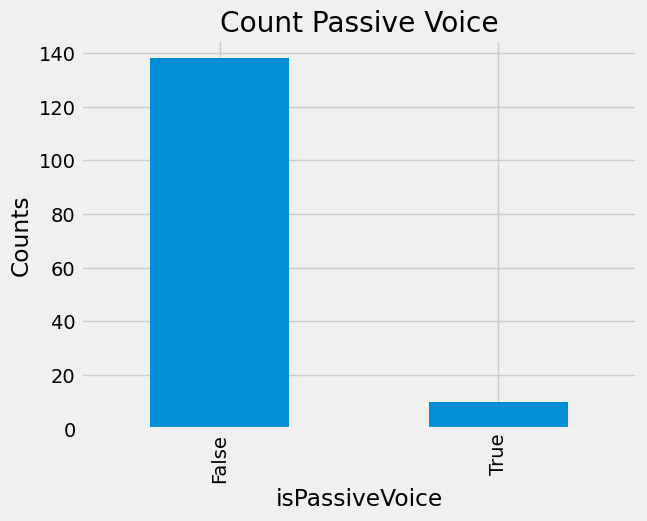

In [27]:
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')
#show the value counts

data[0]['isPassive'].value_counts()

#plot and visualize the counts

plt.title('Count Passive Voice')
plt.xlabel('isPassiveVoice')
plt.ylabel('Counts')
data[0]['isPassive'].value_counts().plot(kind='bar')
plt.show()

In [28]:
dfall = pd.concat(data, axis=1)
#dfall
#dfall['clauses']
data[31]

,clauses,isPassive
0,could face up to a year in jail prosecutors . ...,False
1,could face up to a year in jail prosecutors . ...,False
2,could face up to a year in jail prosecutors . say,False
3,Matter mural on July 4 officials said,False
4,them vandalizing a Black Lives,False
5,Two white people in California other offenses ...,True
6,Two white people in California other offenses ...,False
7,The mural completed last weekend completed las...,False
8,The mural completed last weekend was a peacefu...,False
9,the district attorney said,False


In [29]:
from textblob import TextBlob
#reate a function to get the subjectivity
def getSubjectivity(text):
    return TextBlob(text).sentiment.subjectivity
# create function to get the polarity
def getPolarity(text):
    return TextBlob(text).sentiment.polarity

#create two new columns
##loop for all articles
for i in range(len(data)):
    data[i]['Subjectivity'] = data[i]['clauses'].apply(getSubjectivity)
    data[i]['Polarity']= data[i]['clauses'].apply(getPolarity)  
# create a function to compute the negative, neutral and positive analysis
def getAnalysis(score):
    if score < 0:
        return 'Negative'
    elif score == 0:
        return 'Neutral'
    else:
        return 'Positive'
for i in range(len(data)):
    data[i]['Analysis'] = data[i]['Polarity'].apply(getAnalysis)

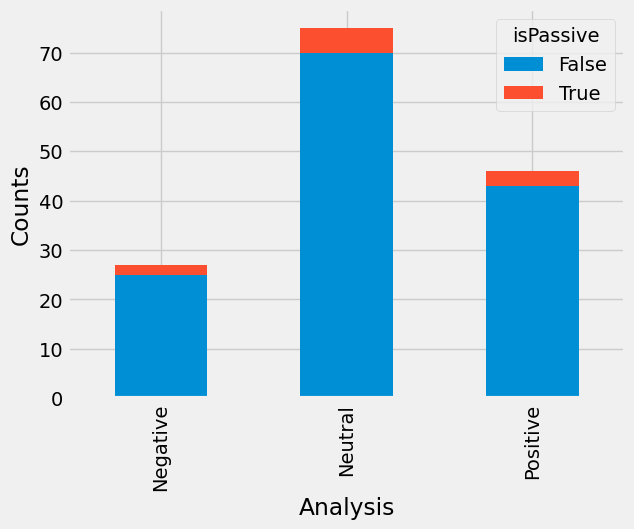

In [30]:
data[0].groupby(['Analysis','isPassive']).size().unstack().plot(kind='bar',stacked=True)
plt.ylabel('Counts')
plt.show()

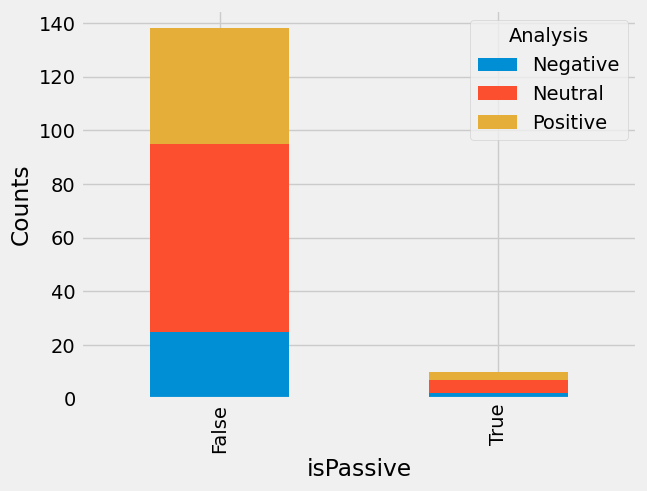

In [31]:
data[0].groupby(['isPassive','Analysis']).size().unstack().plot(kind='bar',stacked=True)
plt.ylabel('Counts')
plt.show()

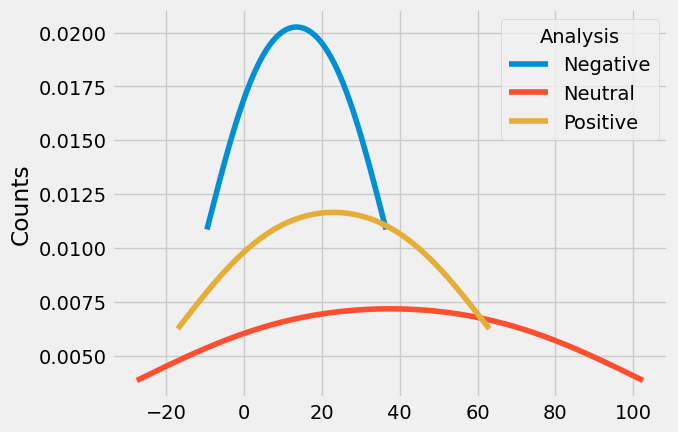

In [32]:
data[0].groupby(['isPassive','Analysis']).size().unstack().plot(kind='kde',stacked=True)
plt.ylabel('Counts')
plt.show()

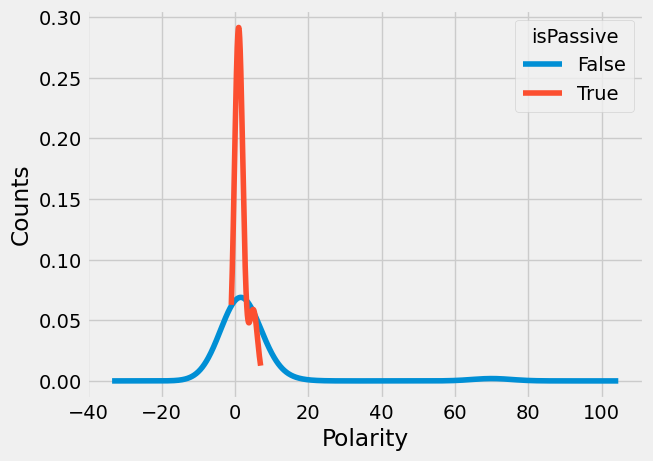

In [33]:
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')
data[0].groupby(['Polarity','isPassive']).size().unstack().plot(kind='kde',stacked=True)
plt.ylabel('Counts')
plt.xlabel('Polarity')
plt.show()

In [34]:
import pickle
with open("Draft/All_df_Clauses.pkl", "wb") as fp:   #Pickling
    pickle.dump(data, fp)

In [35]:
import pickle
with open("Draft/All_df_Clauses.pkl","rb") as fp:
    All_Data_Clauses = pickle.load(fp)
#All_Data_Clauses[0]
len(All_Data_Clauses)

84

In [36]:
import pickle
with open("Draft/AllDataframe.txt", "rb") as fp:   # Unpickling
    df= pickle.load(fp)

In [37]:
df['Title'][22]

'Huntsville Station'

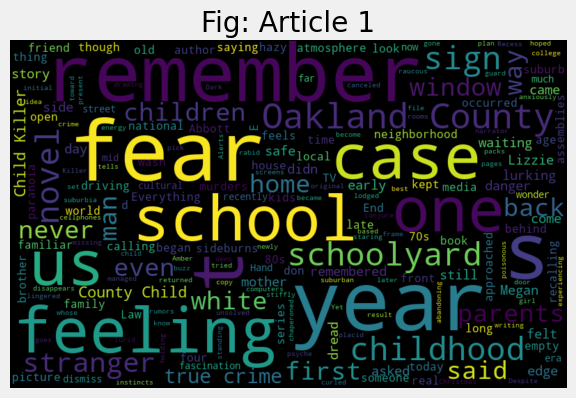

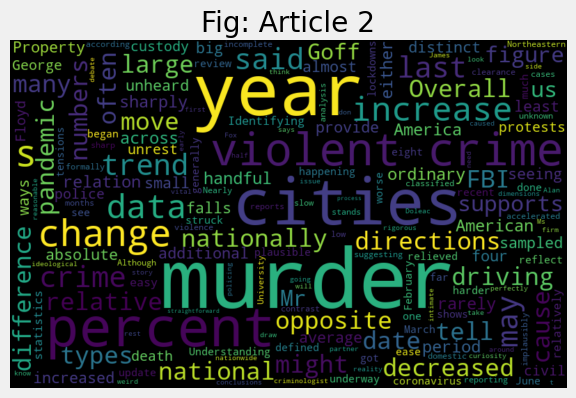

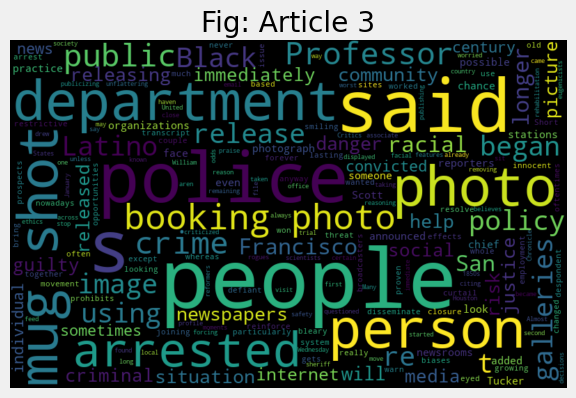

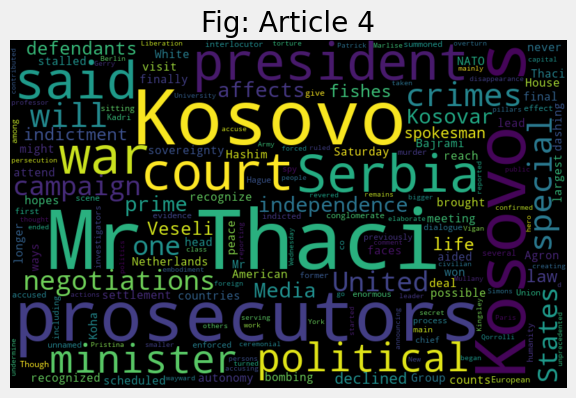

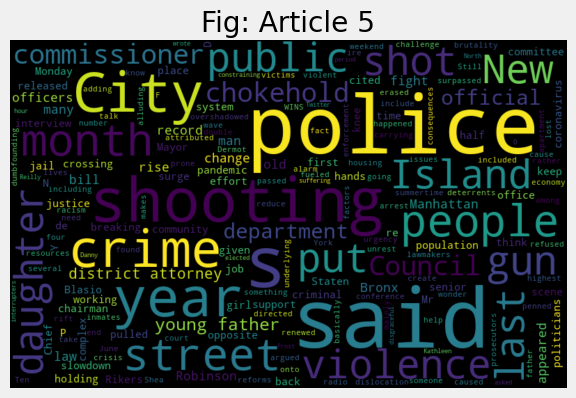

...

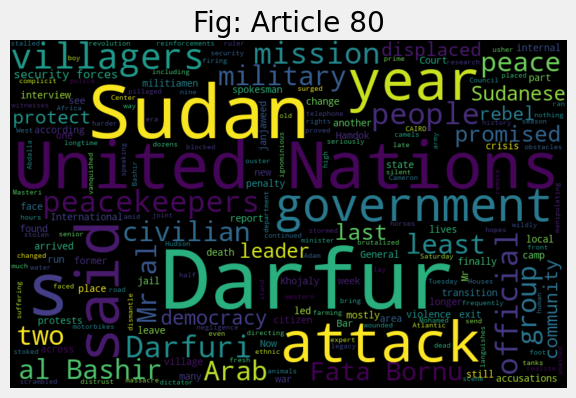

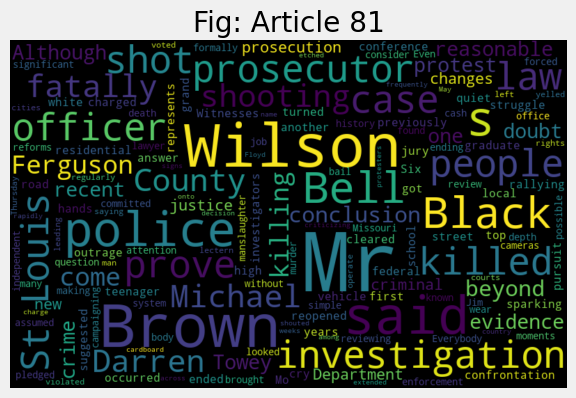

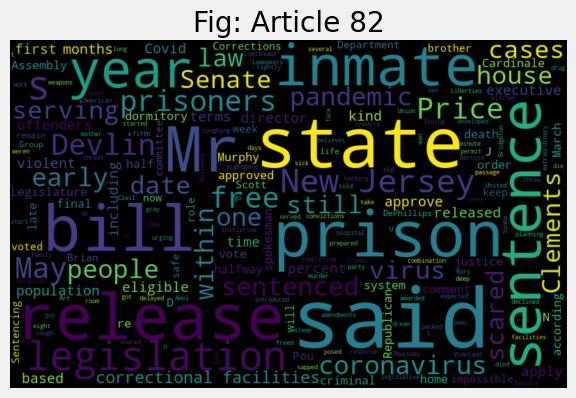

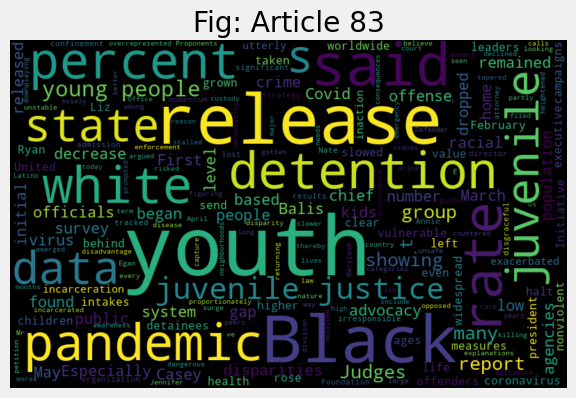

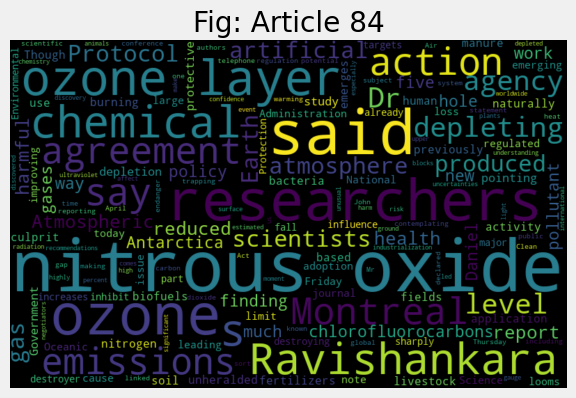

In [38]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
#plt.style.use('fivethirtyeight')
#plt.subplots(3, 4)
# plot the word cloud
#allWords = df['Text'][0]
for i in range(len(df['Text'])):
    wordCloud = WordCloud(width = 800, height = 500,random_state = 21, max_font_size =119).generate(df['Text'][i])
    plt.imshow(wordCloud,interpolation = "bilinear")
    plt.title('Fig: Article '+str(i+1))
    plt.axis('off')
    plt.show()

In [39]:
import pickle
with open("Draft/AllDataframe.txt", "rb") as fp:   # Unpickling
    df= pickle.load(fp)

In [40]:
df

,Title,Text,nSent,nWords
0,‘The Streets Look So Empty’: How a Child Kille...,True Crime The still unsolved Oakland County ...,73,1449
1,It’s Been ‘Such a Weird Year.’ That’s Also Ref...,In large cities across America murders are up...,25,602
2,The Mug Shot a Crime Story Staple Is Dropped...,The San Francisco Police Department said it w...,32,744
3,Kosovo President Is Indicted for War Crimes fo...,President Hashim Thaci who was scheduled to v...,18,417
4,64 Shot 10 Dead: Spike in Gun Violence Alarms...,The victims included a young father who was s...,40,1067
...,...,...,...,...
79,The Dictator Who Waged War on Darfur Is Gone ...,The ouster of Sudan’s longtime ruler last yea...,52,1063
80,No Charges for Ferguson Officer Who Killed Mic...,The St. Louis County prosecutor had reopened ...,18,451
81,About 20% of N.J. Prisoners Could Be Freed to ...,Believed to be the first Covid 19 bill of its...,43,1039
82,Virus-Driven Push to Release Juvenile Detainee...,After an initial decrease in the youth detent...,21,632


In [41]:
import nltk
from nltk.tag import StanfordNERTagger
from nltk.tokenize import word_tokenize
from textblob import TextBlob
import pandas as pd
from itertools import groupby
from operator import itemgetter
from collections import Counter

import pickle

with open("Draft/AllDataframe.txt", "rb") as fp:   # Unpickling
    df= pickle.load(fp)

st = StanfordNERTagger(
'C:/Stanford/stanford-ner-4.0.0/classifiers/english.all.3class.distsim.crf.ser.gz',
'C:/Stanford/stanford-ner-4.0.0/stanford-ner.jar',
encoding='utf-8')

def get_Entity(text):
    tokenized_text = nltk.word_tokenize(text)
    classified_text = st.tag(tokenized_text)
    netagged_words = classified_text
    entities = []
    labels = []
    from itertools import groupby
    for tag, chunk in groupby(classified_text, lambda x:x[1]):
        if tag != "O":
            entities.append(' '.join(w for w, t in chunk))
            labels.append(tag)
    entities_all = list(zip(entities, labels))
    entities_unique = list(set(zip(entities, labels))) #unique entities   
    entities_df = pd.DataFrame(entities_unique)
    entities_df.columns = ["Entity", "Label"]
    return (entities_df)

All_Names = []
for i in range(len(df['Text'])):
    All_Names.append(get_Entity(df['Text'][i]))

In [42]:
All_Names[1]

,Entity,Label
0,Goff,PERSON
1,Doleac,PERSON
2,America,LOCATION
3,Northeastern University,ORGANIZATION
4,James Alan Fox,PERSON
5,George Floyd,PERSON
6,FBI,ORGANIZATION


In [43]:
 import pickle
with open("Draft/AllNames.txt", "wb") as fp:   #Pickling
    pickle.dump(All_Names, fp)


In [44]:
import pickle
with open("Draft/AllNames.txt", "rb") as fp:   # Unpickling
    All_Names_Load= pickle.load(fp)
All_Names_Load[2]

,Entity,Label
0,United States,LOCATION
1,Scott,PERSON
2,Fleetwood,PERSON
3,Eberhardt,PERSON
4,William Scott,PERSON
5,San Francisco Police Department,ORGANIZATION
6,Houston Chronicle,ORGANIZATION
7,San Francisco,LOCATION
8,Tucker,PERSON


In [45]:
#type(All_Names_Load[2]['Label'][1])
len(All_Names_Load)

84

In [46]:
#tmp = All_Names_Load[2].loc[All_Names_Load[2]['Label'] == 'PERSON']
All_PER = []
All_LOC = []
All_ORG = []
for i in range(len(All_Names_Load)):
    All_PER.append(All_Names_Load[i].loc[All_Names_Load[i]['Label'] == 'PERSON'])
    All_LOC.append(All_Names_Load[i].loc[All_Names_Load[i]['Label'] == 'LOCATION'])
    All_ORG.append(All_Names_Load[i].loc[All_Names_Load[i]['Label'] == 'ORGANIZATION'])
for i in range(len(All_PER)):
    All_PER[i].reset_index(drop=True, inplace=True)
for i in range(len(All_LOC)):
    All_LOC[i].reset_index(drop=True, inplace=True)
for i in range(len(All_ORG)):
    All_ORG[i].reset_index(drop=True, inplace=True)


In [47]:
All_PER[2]
#All_LOCATIONs[2]
#All_ORGANIZATIONs[3]

,Entity,Label
0,Scott,PERSON
1,Fleetwood,PERSON
2,Eberhardt,PERSON
3,William Scott,PERSON
4,Tucker,PERSON


In [48]:
import pickle
with open("Draft/AllDataframe.txt", "rb") as fp:   # Unpickling
    df= pickle.load(fp)
PERSONs = []
ORGANIZATIONs = []
LOCATIONs = []
for i in range(len(All_PER)):
    PERSONs.append(All_PER[i]['Entity'].to_list())
for i in range(len(All_ORG)):
    ORGANIZATIONs.append(All_ORG[i]['Entity'].to_list())
for i in range(len(All_LOC)):
    LOCATIONs.append(All_LOC[i]['Entity'].to_list())
    
df['PERSONs'] = PERSONs
df['ORGANIZATIONs'] = ORGANIZATIONs
df['LOCATIONs'] = LOCATIONs
#list(PERSONs)
df

,Title,Text,nSent,nWords,PERSONs,ORGANIZATIONs,LOCATIONs
0,‘The Streets Look So Empty’: How a Child Kille...,True Crime The still unsolved Oakland County ...,73,1449,"[Law, Megan, Reagan, Lizzie, Timothy, Megan Ab...","[Oakland County Child Killer, AMC Gremlin]","[Michigan, Oakland County, Detroit]"
1,It’s Been ‘Such a Weird Year.’ That’s Also Ref...,In large cities across America murders are up...,25,602,"[Goff, Doleac, James Alan Fox, George Floyd]","[Northeastern University, FBI]",[America]
2,The Mug Shot a Crime Story Staple Is Dropped...,The San Francisco Police Department said it w...,32,744,"[Scott, Fleetwood, Eberhardt, William Scott, T...","[San Francisco Police Department, Houston Chro...","[United States, San Francisco]"
3,Kosovo President Is Indicted for War Crimes fo...,President Hashim Thaci who was scheduled to v...,18,417,"[Veseli, Patrick Kingsley, Thaci Kadri Veseli,...","[Kosovo Liberation Army, NATO, Koha Media Grou...","[Berlin, Netherlands, Kosovo, United States, N..."
4,64 Shot 10 Dead: Spike in Gun Violence Alarms...,The victims included a young father who was s...,40,1067,"[Anthony Robinson, Danny Frost, Dermot F. Shea...","[City Council, Molloy College]","[Rikers Island, Claremont, Staten Island, Bron..."
...,...,...,...,...,...,...,...
79,The Dictator Who Waged War on Darfur Is Gone ...,The ouster of Sudan’s longtime ruler last yea...,52,1063,"[Fata Bornu, al Bashir, Hamdok, Adam Mohamed, ...","[New York Times, United Nations, State, Darfur...","[Europe, Masteri, Darfur, Chad, CAIRO, Sudan, ..."
80,No Charges for Ferguson Officer Who Killed Mic...,The St. Louis County prosecutor had reopened ...,18,451,"[Brown, Towey, Bell, Michael Brown, Ferguson, ...",[Justice Department],"[Missouri, St. Louis, St. Louis County, Fergus..."
81,About 20% of N.J. Prisoners Could Be Freed to ...,Believed to be the first Covid 19 bill of its...,43,1039,"[Bernice Ferguson, Nicole D. Porter, Philip D....","[State Police, Senate, American Civil Libertie...","[Vineland N.J., United States, New Jersey, Bri..."
82,Virus-Driven Push to Release Juvenile Detainee...,After an initial decrease in the youth detent...,21,632,"[Jennifer L. Egan, Liz Ryan, Joshua Rovner, Ba...","[Youth First Initiative, Juvenile Justice Stra...","[United States, Baltimore]"


In [49]:
import nltk
sentences =[nltk.sent_tokenize(l) for l in df['Text']]

df['Sentences'] = sentences

In [50]:
import pickle
with open("Draft/df_Sentences.pkl", "wb") as fp:   #Pickling
    pickle.dump(df, fp)

In [51]:
import pickle
with open('Draft/df_Sentences.pkl','rb') as fp:
    data_Sent = pickle.load(fp)
data_Sent

,Title,Text,nSent,nWords,PERSONs,ORGANIZATIONs,LOCATIONs,Sentences
0,‘The Streets Look So Empty’: How a Child Kille...,True Crime The still unsolved Oakland County ...,73,1449,"[Law, Megan, Reagan, Lizzie, Timothy, Megan Ab...","[Oakland County Child Killer, AMC Gremlin]","[Michigan, Oakland County, Detroit]",[ True Crime The still unsolved Oakland County...
1,It’s Been ‘Such a Weird Year.’ That’s Also Ref...,In large cities across America murders are up...,25,602,"[Goff, Doleac, James Alan Fox, George Floyd]","[Northeastern University, FBI]",[America],[ In large cities across America murders are u...
2,The Mug Shot a Crime Story Staple Is Dropped...,The San Francisco Police Department said it w...,32,744,"[Scott, Fleetwood, Eberhardt, William Scott, T...","[San Francisco Police Department, Houston Chro...","[United States, San Francisco]",[ The San Francisco Police Department said it ...
3,Kosovo President Is Indicted for War Crimes fo...,President Hashim Thaci who was scheduled to v...,18,417,"[Veseli, Patrick Kingsley, Thaci Kadri Veseli,...","[Kosovo Liberation Army, NATO, Koha Media Grou...","[Berlin, Netherlands, Kosovo, United States, N...",[ President Hashim Thaci who was scheduled to ...
4,64 Shot 10 Dead: Spike in Gun Violence Alarms...,The victims included a young father who was s...,40,1067,"[Anthony Robinson, Danny Frost, Dermot F. Shea...","[City Council, Molloy College]","[Rikers Island, Claremont, Staten Island, Bron...",[ The victims included a young father who was ...
...,...,...,...,...,...,...,...,...
79,The Dictator Who Waged War on Darfur Is Gone ...,The ouster of Sudan’s longtime ruler last yea...,52,1063,"[Fata Bornu, al Bashir, Hamdok, Adam Mohamed, ...","[New York Times, United Nations, State, Darfur...","[Europe, Masteri, Darfur, Chad, CAIRO, Sudan, ...",[ The ouster of Sudan’s longtime ruler last ye...
80,No Charges for Ferguson Officer Who Killed Mic...,The St. Louis County prosecutor had reopened ...,18,451,"[Brown, Towey, Bell, Michael Brown, Ferguson, ...",[Justice Department],"[Missouri, St. Louis, St. Louis County, Fergus...",[ The St. Louis County prosecutor had reopened...
81,About 20% of N.J. Prisoners Could Be Freed to ...,Believed to be the first Covid 19 bill of its...,43,1039,"[Bernice Ferguson, Nicole D. Porter, Philip D....","[State Police, Senate, American Civil Libertie...","[Vineland N.J., United States, New Jersey, Bri...",[ Believed to be the first Covid 19 bill of it...
82,Virus-Driven Push to Release Juvenile Detainee...,After an initial decrease in the youth detent...,21,632,"[Jennifer L. Egan, Liz Ryan, Joshua Rovner, Ba...","[Youth First Initiative, Juvenile Justice Stra...","[United States, Baltimore]",[ After an initial decrease in the youth deten...


In [52]:
import pandas as pd
dfs_Sent = []
for i in range(len(data_Sent['Sentences'])):
    dfs_Sent.append(pd.DataFrame(data_Sent['Sentences'][i],columns =['Sentences']))

In [ ]:
import Kernel as ker
import nltk
from nltk.stem import PorterStemmer 

ps = PorterStemmer()
AUXs = ['be','Be','been','Been','am','Am','is','me','Me','Is','isn','Isn','are','Are','aren','Aren','was','Was','wasn','Wasn','were','Were','will','Will','have','Have','had','Had','has','hasn','Has','Hasn','won','Won', 'do','Do','Did', 'did' ,'Didn','didn','don','Don','hav','Hav', 'I', 'i', 'it', 'It', 'he','He','she', 'She','you', 'You','we','We','they','They']
for i in range(len(dfs_Sent)):
    All_VERB = []
    Sent_Words = []
    for j in range(len(dfs_Sent[i]['Sentences'])):
        VERB = []
        for word,pos in nltk.pos_tag(nltk.word_tokenize(str(dfs_Sent[i]['Sentences'][j]))):
            if (pos == 'VB' or pos == 'VBD' or pos == 'VBG' or pos == 'VBN' or pos =='VBP' or pos == 'VBZ' or pos == 'NN' or pos == 'JJ' or pos == 'NNS' or pos == 'NNP' or pos == 'JJR' or pos == 'JJS' or pos == 'NNP' or pos == 'NNPS' or pos == 'PRP' or pos == 'RB' or pos == 'RBR' or pos == 'RBS' ):
                if len(word) > 1 and word not in AUXs:
                    VERB.append(ps.stem(word))
        Sent_Words.append(VERB)
        
    dfs_Sent[i]['Sent_key_Words'] = Sent_Words
dfs_Sent[1]

In [ ]:
dfs_Sent[1]

In [ ]:
import math
from collections import Counter
from nltk.stem import PorterStemmer 

ps = PorterStemmer()
crimy = ['APB','Assault','Blackmail','Burglary','Fraud','Hijacking','Hooliganism','Kidnapping','Mugging',
         'Murderer','Robber','Shoplifter','Smuggler','Terrorist','Thief','Vandal',
         'Arrest','Ban','Break-in','Break-out','Break the law','Burgle','Charge','Escape','report','Getaway',
         'Hold up','Investigate','Rob','Steal',
         'Alibi','Armed','Burglar','Alarm','Illegal','Weapon','crime']
crimy_stem = [ps.stem(word) for word in crimy]
def get_cosine(vec1, vec2):
    intersection = set(vec1.keys()) & set(vec2.keys())
    numerator = sum([vec1[x] * vec2[x] for x in intersection])

    sum1 = sum([vec1[x] ** 2 for x in list(vec1.keys())])
    sum2 = sum([vec2[x] ** 2 for x in list(vec2.keys())])
    denominator = math.sqrt(sum1) * math.sqrt(sum2)

    if not denominator:
        return 0.0
    else:
        return float(numerator) / denominator
    
for i in range(len(dfs_Sent)):
    tmp = []
    for j in range(len(dfs_Sent[i])):
        tmp.append(get_cosine(Counter(dfs_Sent[i]['Sent_key_Words'][j]),Counter(crimy_stem)))
    dfs_Sent[i]['how_similar'] = tmp



In [ ]:
dfs_Sent[0]

In [ ]:
tmp = []
Sentoss = []
#dfs_Sent[0]['how_similar'].nlargest(3).index
for i in range(len(dfs_Sent)):
    Sentss = []
    tmp = dfs_Sent[i]['how_similar'].nlargest(3).index
    #print(tmp)
    for k in tmp:
        Sentss.append(dfs_Sent[i]['Sentences'][k])
    Sentoss.append(Sentss)

data_Sent['Sentence_key'] = Sentoss
data_Sent

In [ ]:
import pickle
with open("Draft/data_Sent.pkl","wb") as fp:
    pickle.dump(data_Sent,fp)

In [ ]:
import pickle
with open("Draft/data_Sent.pkl","rb") as fp:
    data_Sent = pickle.load(fp)
data_Sent

In [ ]:
import pickle
with open("Draft/All_df_Clauses.pkl","rb") as fp:
    All_Data_Clauses = pickle.load(fp)
len(All_Data_Clauses)

In [ ]:
#Add each person as a column that contains the number how much the name is occured in each clause 
import re
for i in range(len(data_Sent['PERSONs'])):
    
    for j in range(len(data_Sent['PERSONs'][i])):
        Count = []
        for k in range(len(All_Data_Clauses[i]['clauses'])):
            Count.append(sum(1 for _ in re.finditer(r'\b%s\b' % re.escape(data_Sent['PERSONs'][i][j]), All_Data_Clauses[i]['clauses'][k])))
        All_Data_Clauses[i][data_Sent['PERSONs'][i][j]] = Count

#set the PERSONs Column number of persons exist in the clause
for i in range(len(All_Data_Clauses)):
    All_Data_Clauses[i]['PERSONs'] = [0] * len(All_Data_Clauses[i])
    for k in range(len(data_Sent['PERSONs'][i])):
        All_Data_Clauses[i]['PERSONs'] += All_Data_Clauses[i][data_Sent['PERSONs'][i][k]]
All_Data_Clauses[0]

In [ ]:
import re
#Add each person as a column that contains the number how much the name is occured in each clause 
for i in range(len(data_Sent['LOCATIONs'])):
    
    for j in range(len(data_Sent['LOCATIONs'][i])):
        Count = []
        for k in range(len(All_Data_Clauses[i]['clauses'])):
            Count.append(sum(1 for _ in re.finditer(r'\b%s\b' % re.escape(data_Sent['LOCATIONs'][i][j]), All_Data_Clauses[i]['clauses'][k])))
        All_Data_Clauses[i][data_Sent['LOCATIONs'][i][j]] = Count
        
#set the LOCATIONs Column number of locations exist in the clause
for i in range(len(All_Data_Clauses)):
    All_Data_Clauses[i]['LOCATIONs'] = [0] * len(All_Data_Clauses[i])
    for k in range(len(data_Sent['LOCATIONs'][i])):
        All_Data_Clauses[i]['LOCATIONs'] += All_Data_Clauses[i][data_Sent['LOCATIONs'][i][k]]
All_Data_Clauses[0]

In [ ]:
import re
#Add each person as a column that contains the number how much the name is occured in each clause 
for i in range(len(data_Sent['ORGANIZATIONs'])):
    
    for j in range(len(data_Sent['ORGANIZATIONs'][i])):
        Count = []
        for k in range(len(All_Data_Clauses[i]['clauses'])):
            Count.append(sum(1 for _ in re.finditer(r'\b%s\b' % re.escape(data_Sent['ORGANIZATIONs'][i][j]), All_Data_Clauses[i]['clauses'][k])))
        All_Data_Clauses[i][data_Sent['ORGANIZATIONs'][i][j]] = Count
        
#set the LOCATIONs Column number of locations exist in the clause
for i in range(len(All_Data_Clauses)):
    All_Data_Clauses[i]['ORGANIZATIONs'] = [0] * len(All_Data_Clauses[i])
    for k in range(len(data_Sent['ORGANIZATIONs'][i])):
        All_Data_Clauses[i]['ORGANIZATIONs'] += All_Data_Clauses[i][data_Sent['ORGANIZATIONs'][i][k]]
All_Data_Clauses[0]

In [ ]:
data_Sent['TActiveClauses'] = [df.isPassive[df.isPassive==False].count() for df in All_Data_Clauses]
data_Sent['TPassiveClauses'] = [df.isPassive[df.isPassive==True].count() for df in All_Data_Clauses]
data_Sent

In [ ]:
data_Sent['PERActiveClauses'] = [df.query("isPassive == False")['PERSONs'].pct_change().fillna(0).gt(0).sum() for df in All_Data_Clauses]
data_Sent['PERPassiveClauses'] = [df.query("isPassive == True")['PERSONs'].pct_change().fillna(0).gt(0).sum() for df in All_Data_Clauses]
data_Sent['LOCActiveClauses'] = [df.query("isPassive == False")['LOCATIONs'].pct_change().fillna(0).gt(0).sum() for df in All_Data_Clauses]
data_Sent['LOCPassiveClauses'] = [df.query("isPassive == True")['LOCATIONs'].pct_change().fillna(0).gt(0).sum() for df in All_Data_Clauses]
data_Sent['ORGActiveClauses'] = [df.query("isPassive == False")['ORGANIZATIONs'].pct_change().fillna(0).gt(0).sum() for df in All_Data_Clauses]
data_Sent['ORGPassiveClauses'] = [df.query("isPassive == True")['ORGANIZATIONs'].pct_change().fillna(0).gt(0).sum() for df in All_Data_Clauses]

data_Sent

In [ ]:
data_Sent[['Title','Text','PERSONs','ORGANIZATIONs','LOCATIONs','PERActiveClauses','PERPassiveClauses','LOCActiveClauses','LOCPassiveClauses','ORGActiveClauses','ORGPassiveClauses']]

In [ ]:
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')
Articles = data_Sent.index

Persons_Passive = data_Sent['PERPassiveClauses']
Organizations_Passive = data_Sent['ORGPassiveClauses']
Locations_Passive = data_Sent['LOCPassiveClauses']

plt.plot([],[], color='y', label = 'PER_Passive')
plt.plot([],[], color='r', label = 'ORG_Passive')
plt.plot([],[], color='b', label = 'LOC_Passive ')

plt.stackplot(Articles, Persons_Passive, Organizations_Passive, Locations_Passive, colors = ['y','r','b'])
plt.legend()
plt.title('Passive Clauses for NER')
plt.xlabel('Articles')
plt.ylabel('Passive CLauses')
plt.show()